In [44]:
import sys

sys.path.insert(0, "/sailhome/alanqw/brainmorph")
sys.path.insert(0, "/sailhome/alanqw/keymorph")
sys.path.insert(0, "/sailhome/alanqw/voxelmorph")
sys.path.insert(0, "/sailhome/alanqw/rssl")
sys.path.insert(0, "/sailhome/alanqw/3D-TransUNet")
import json
import os
import random
from argparse import ArgumentParser
from copy import deepcopy
from pathlib import Path
from pprint import pprint

import numpy as np
import torch
import torchio as tio
from keymorph.model import KeyMorph
from voxelmorph.model import VoxelMorph

import scripts.hyperparameters as hps
import wandb
from dataset import (
    adni_dataset,
    csv_dataset,
    nnunet_dataset,
    synapse_dataset,
    gigamed_dataset,
)
from rssl import utils as keymorph_utils
from rssl.model import FinetuneModel, RSSL
from rssl.net import (
    UNetDecoder,
    UNetEncoder,
    ConvNetDecoder,
    SingleLayerDecoder,
    UNetDecoderHalf,
)
from rssl.unet3d.model import TruncatedUNet3D, UNet2D, UNet3D
from rssl.viz_tools import imshow_img_and_points_3d
from scripts import script_utils
from scripts.eval import run_eval
from scripts.pretrain import (
    run_pretrain_equiv,
    run_pretrain_regequiv,
    run_pretrain_ssl,
    run_pretrain_rssl,
    run_pretrain_rssldecode,
    run_pretrain_recon,
)
from scripts.script_utils import ParseKwargs, initialize_wandb, save_dict_as_json
from scripts.train import run_train, run_val

from rssl.utils import align_img, displacement2pytorchflow, random_masking, one_hot

In [19]:
def get_encoder(args):
    if args.backbone == "unet3d_encoder":
        network = UNet3D(
            1,
            1,
            final_sigmoid=False,
            f_maps=32,  # Used by nnUNet
            layer_order="gcr",
            num_groups=8,
            num_levels=args.num_levels_for_unet,
            is_segmentation=False,
            conv_padding=1,
            use_checkpoint=args.use_checkpoint,
        )
        network.decoders = torch.nn.ModuleList([])
        network.final_conv = torch.nn.Identity()
        encoder = network

    elif args.backbone == "swin_unetr":
        from monai.networks.nets.swin_unetr import SwinTransformer as SwinViT

        encoder = SwinViT(
            in_chans=1,
            embed_dim=48,
            window_size=(2, 2, 2),
            patch_size=(2, 2, 2),
            depths=[2, 2, 2, 2],
            num_heads=[3, 6, 12, 24],
            mlp_ratio=4.0,
            qkv_bias=True,
            drop_rate=0.0,
            attn_drop_rate=0.0,
            drop_path_rate=0.0,
            norm_layer=torch.nn.LayerNorm,
            use_checkpoint=args.use_checkpoint,
            spatial_dims=args.dim,
        )

        # from monai.networks.nets.swin_unetr import SwinUNETR

        # encoder = SwinUNETR(
        #     img_size=(256, 256, 256),
        #     in_channels=1,
        #     out_channels=256,
        #     depths=[2, 2, 2, 2],
        #     num_heads=[3, 6, 12, 24],
        #     use_checkpoint=args.use_checkpoint,
        #     spatial_dims=args.dim,
        # )

        class SelectElement(torch.nn.Module):
            def __init__(self, index):
                super(SelectElement, self).__init__()
                self.index = index

            def forward(self, x):
                # print("1", x.shape)
                # print("2", x[self.index].shape)
                return x[self.index]

        encoder = torch.nn.Sequential(
            encoder, SelectElement(index=4)  # Select the 4th element (index 3)
        )

    elif args.backbone == "transunet":
        from nn_transunet.networks.transunet3d_model import (
            Generic_TransUNet_max_ppbp as TransUNet3d,
        )

        encoder = TransUNet3d(
            input_channels=1,
            base_num_features=64,
            num_classes=1,
            num_pool=1,
            is_max=False,
            conv_op=torch.nn.Conv3d,
            norm_op=torch.nn.BatchNorm3d,
            dropout_op=torch.nn.Dropout3d,
            is_max_bottleneck_transformer=True,
            deep_supervision=False,
            convolutional_upsampling=True,
            patch_size=(160, 192, 176),
        )
        encoder.tu = torch.nn.Identity()

    elif args.backbone == "monai_autoencoderkl_encoder":
        from nn_transunet.networks.transunet3d_model import (
            Generic_TransUNet_max_ppbp as TransUNet3d,
        )

        encoder = TransUNet3d(
            input_channels=1,
            base_num_features=64,
            num_classes=1,
            num_pool=1,
            is_max=False,
            conv_op=torch.nn.Conv3d,
            norm_op=torch.nn.BatchNorm3d,
            dropout_op=torch.nn.Dropout3d,
            is_max_bottleneck_transformer=True,
            deep_supervision=False,
            convolutional_upsampling=True,
            patch_size=(160, 192, 176),
        )
        encoder.tu = torch.nn.Identity()
    else:
        # encoder = ConvNetEncoder(3, 1, 1, "instance")
        raise ValueError("Invalid encoder")

    if args.freeze_encoder:
        for param in encoder.parameters():
            param.requires_grad = False

    return encoder


def get_decoder(in_channels, out_channels, args):
    if args.decoder_type == "large_kernel_deconv":
        decoder = torch.nn.ConvTranspose3d(
            in_channels, out_channels, kernel_size=(32, 32, 32), stride=(32, 32, 32)
        )
    elif args.decoder_type == "deconv":
        dim = in_channels
        decoder = torch.nn.Sequential(
            torch.nn.ConvTranspose3d(
                dim, dim // 2, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            torch.nn.ConvTranspose3d(
                dim // 2, dim // 4, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            torch.nn.ConvTranspose3d(
                dim // 4, out_channels, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            # torch.nn.ConvTranspose3d(
            #     dim // 8, dim // 16, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            # ),
            # torch.nn.ConvTranspose3d(
            #     dim // 16, out_channels, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            # ),
        )

    elif args.decoder_type == "deconv_bn_relu":
        dim = in_channels
        decoder = torch.nn.Sequential(
            torch.nn.BatchNorm3d(dim),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose3d(
                dim, dim // 2, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            torch.nn.BatchNorm3d(dim // 2),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose3d(
                dim // 2, dim // 4, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            torch.nn.BatchNorm3d(dim // 4),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose3d(
                dim // 4, out_channels, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            ),
            # torch.nn.ConvTranspose3d(
            #     dim // 8, dim // 16, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            # ),
            # torch.nn.ConvTranspose3d(
            #     dim // 16, out_channels, kernel_size=(2, 2, 2), stride=(2, 2, 2)
            # ),
        )
    elif args.decoder_type == "convnet":
        decoder = UNetDecoder(3, in_channels, out_channels, "batch")
    elif args.decoder_type == "convnethalf":
        decoder = UNetDecoderHalf(3, in_channels, out_channels, "batch")
    else:
        raise ValueError("Invalid decoder type")

    return decoder


def get_model(args):
    encoder = get_encoder(args)

    if args.num_proj_channels > 0:
        num_latent_channels = args.num_proj_channels
    else:
        num_latent_channels = 768 if args.backbone == "swin_unetr" else 256
    if args.run_mode == "pretrain" and args.pretrain_type in ["rssldecode"]:
        reg_decoder = get_decoder(
            in_channels=num_latent_channels * 2,
            out_channels=3,
            args=args,
        )
        model = RSSL(
            encoder,
            reg_decoder=reg_decoder,
            use_checkpoint=args.use_checkpoint,
            num_proj_channels=args.num_proj_channels,
        )
    elif args.run_mode == "pretrain" and args.pretrain_type in ["recon"]:
        recon_decoder = get_decoder(
            in_channels=num_latent_channels,
            out_channels=1,
            args=args,
        )
        model = RSSL(
            encoder,
            recon_decoder=recon_decoder,
            use_checkpoint=args.use_checkpoint,
            num_proj_channels=args.num_proj_channels,
        )
    elif args.run_mode == "pretrain" and args.pretrain_type in ["ssl"]:
        model = RSSL(
            encoder,
            num_proj_channels=args.num_proj_channels,
            num_proj_dim=num_latent_channels,
            use_checkpoint=args.use_checkpoint,
        )
    elif args.run_mode == "train" and args.label_name == "seg":
        model = UNet3D(
            1,
            33,
            final_sigmoid=False,
            f_maps=32,  # Used by nnUNet
            layer_order="gcr",
            num_groups=8,
            num_levels=args.num_levels_for_unet,
            is_segmentation=False,
            conv_padding=1,
            use_checkpoint=args.use_checkpoint,
        )
    else:
        # Main prediction network
        if args.label_name == "age":
            output_dim = 1
        elif args.label_name == "sex":
            output_dim = 2
        elif args.label_name == "group":
            output_dim = 3
        else:
            raise ValueError
        if args.backbone == "swin_unetr":
            model = UNETR()
        else:
            model = FinetuneModel(
                encoder,
                output_dim=output_dim,
                dim=args.dim,
                use_checkpoint=args.use_checkpoint,
            )
    model.to(args.device)
    script_utils.summary(model)

    if args.run_mode == "pretrain" and args.pretrain_type in ["reg", "rssl"]:
        registration_model = get_registration_model(args)
        return model, registration_model
    else:
        return model

def get_data(args):
    if args.train_dataset == "csv":
        dataset = csv_dataset.CSVDataset(args.data_path)
    elif args.train_dataset == "nnunet":
        dataset = nnunet_dataset.NNUnetDataset(args.data_path)
    elif args.train_dataset == "adni":
        transform = tio.Compose(
            [
                tio.Lambda(keymorph_utils.rescale_intensity, include=("img",)),
            ]
        )
        dataset = adni_dataset.ADNIDataset(args.data_path)
    elif args.train_dataset == "adnisynthseg":
        transform = tio.Compose(
            [
                tio.Lambda(keymorph_utils.rescale_intensity, include=("img",)),
            ]
        )
        dataset = adni_dataset.ADNISynthSegDataset(args.data_path)
        args.num_segmentations = 33  # num segmentations
    elif args.train_dataset == "synapse":
        dataset = synapse_dataset.SynapseDataset(args.data_path)
    elif "gigamed" in args.train_dataset:
        transform = tio.Compose(
            [
                tio.ToCanonical(),
                tio.CropOrPad((224, 224, 224), padding_mode=0, include=("img",)),
                tio.CropOrPad((224, 224, 224), padding_mode=0, include=("seg",)),
                tio.Lambda(keymorph_utils.rescale_intensity, include=("img",)),
            ]
        )
        if args.train_dataset == "gigamed_skullstripped_samemod":
            same_mod_training = True
        elif args.train_dataset == "gigamed_skullstripped":
            same_mod_training = False
        else:
            raise ValueError('Invalid train datasets "{}"'.format(args.train_dataset))

        dataset = gigamed_dataset.GigaMed(
            args.batch_size,
            args.num_workers,
            transform=transform,
            include_seg=False,
            same_mod_training=same_mod_training,
        )
    else:
        raise ValueError('Invalid dataset "{}"'.format(args.train_dataset))

    args.seg_available = dataset.seg_available
    args.num_segmentations = 33  # num segmentations
    return {
        "transform": transform,
        "pretrain": dataset.get_pretrain_loader(
            args.batch_size,
            args.num_workers,
            transform=transform,
            paired=(
                True
                if args.pretrain_type in ["reg", "ssl", "rssl", "rssldecode", "recon"]
                else False
            ),
        ),
        "train": dataset.get_train_loader(
            args.batch_size, args.num_workers, transform=transform, paired=False
        ),
        "val": dataset.get_val_loader(
            args.batch_size, args.num_workers, transform=transform, paired=False
        ),
        "eval": dataset.get_test_loader(
            args.batch_size, args.num_workers, transform=transform, paired=False
        ),
        "reference_subject": dataset.get_reference_subject(transform),
    }

In [42]:
class Args:
    pass

args = Args()
args.run_mode = "pretrain"
args.pretrain_type = 'rssldecode'
args.backbone = 'unet3d_encoder'
args.num_levels_for_unet = 4
args.use_checkpoint = False
args.freeze_encoder = False
args.num_proj_channels = 3
args.decoder_type = 'convnet'
args.device = 'cuda'

pretrained_load_path = '/simurgh/u/alanqw/experiments/__pretrain__convnetdecode_numprojchannels3_maskratio0.0_aff0.1_0.1_0.25_0.1_gradloss5_dataadni_batch1_lr0.0001/checkpoints/pretrained_epoch1600_model.pth.tar'

model = get_model(args)
_, model = script_utils.load_checkpoint(pretrained_load_path, model)
print(model.state_dict().keys())
print(torch.load(pretrained_load_path)['state_dict'].keys())


Model Summary
---------------------------------------------------------------
encoder.encoders.0.basic_module.SingleConv1.groupnorm.weight 1
encoder.encoders.0.basic_module.SingleConv1.groupnorm.bias 1
encoder.encoders.0.basic_module.SingleConv1.conv.weight 432
encoder.encoders.0.basic_module.SingleConv2.groupnorm.weight 16
encoder.encoders.0.basic_module.SingleConv2.groupnorm.bias 16
encoder.encoders.0.basic_module.SingleConv2.conv.weight 13824
encoder.encoders.1.basic_module.SingleConv1.groupnorm.weight 32
encoder.encoders.1.basic_module.SingleConv1.groupnorm.bias 32
encoder.encoders.1.basic_module.SingleConv1.conv.weight 27648
encoder.encoders.1.basic_module.SingleConv2.groupnorm.weight 32
encoder.encoders.1.basic_module.SingleConv2.groupnorm.bias 32
encoder.encoders.1.basic_module.SingleConv2.conv.weight 55296
encoder.encoders.2.basic_module.SingleConv1.groupnorm.weight 64
encoder.encoders.2.basic_module.SingleConv1.groupnorm.bias 64
encoder.encoders.2.basic_module.SingleConv1.con

/tmp/alanqw/ipykernel_3155106/1139487521.py:20: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  print(torch.load(pretrained_load_path)['state_dict'].keys())


In [31]:
args.data_path = ''
args.train_dataset = 'adni'
args.batch_size = 1
args.num_workers = 0

train_loader = get_data(args)['eval']

Found subject_dict_splits_separated_by_subjectid.pkl!
Total unique subjects: 939
Group Frequencies Across All Images:
EMCI: 2261
LMCI: 1010
CN: 1984
AD: 638
MCI: 749
Total train images: 5290
Total validation images: 301
Total test images: 1051
Preprocessing...


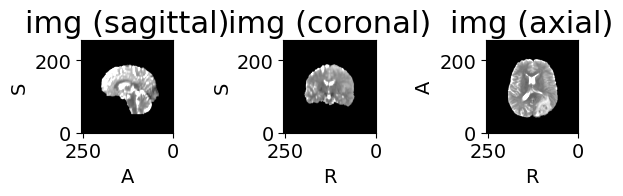

torch.Size([1, 1, 160, 192, 176]) torch.Size([1, 1, 160, 192, 176])
tensor(0., device='cuda:0') tensor(1., device='cuda:0') tensor(0., device='cuda:0') tensor(1., device='cuda:0')


In [110]:
img_m = next(iter(train_loader))['img']['data'].float().to(args.device)

brats_path = '/simurgh/u/alanqw/data/nnUNet_1mmiso_256x256x256_MNI_HD-BET_preprocessed/Dataset5000_BraTS-GLI_2023/imagesTr/BraTS-GLI_2023_000608_0000.nii.gz'
brats_path = '/simurgh/u/alanqw/data/nnUNet_1mmiso_256x256x256_MNI_HD-BET_preprocessed/Dataset5000_BraTS-GLI_2023/imagesTr/BraTS-GLI_2023_000492_0000.nii.gz'
# brats_path = '/simurgh/u/alanqw/data/nnUNet_1mmiso_256x256x256_MNI_HD-BET_preprocessed/Dataset5003_BraTS-MET_2023/imagesTr/BraTS-MET_2023_000193_0000.nii.gz'
# brats_path = '/simurgh/u/alanqw/data/nnUNet_1mmiso_256x256x256_MNI_HD-BET_preprocessed/Dataset5042_BRATS2016/imagesTr/BRATS2016_931_0000.nii.gz'
brats_path = '/simurgh/u/alanqw/data/nnUNet_1mmiso_256x256x256_MNI_HD-BET_preprocessed/Dataset5038_BrainTumour/imagesTr/BRATS_484_0003.nii.gz'
img_f = tio.Subject(img=tio.ScalarImage(brats_path))
img_f.plot()
img_f = img_f['img']['data'][None][:, :, 48:-48, 32:-32, 40:-40].float().to(args.device)
print(img_m.shape, img_f.shape)
print(img_m.min(), img_m.max(), img_f.min(), img_f.max())

In [111]:
model_dict = model(img_m, img_f)
disp = model_dict['reg_out']
disp_permute = disp.permute(0, 2, 3, 4, 1)
flow = displacement2pytorchflow(disp_permute, input_space="norm")
flow = flow.float()
img_a = align_img(flow, img_m)

err_img = (img_a - img_f).abs()

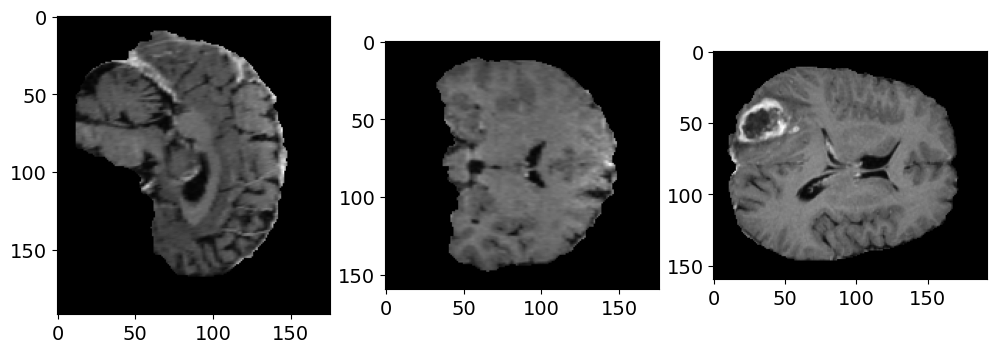

In [108]:
fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(img_f[0, 0, 80].cpu().detach().numpy(), cmap='gray')
axes[1].imshow(img_f[0, 0, :, 96].cpu().detach().numpy(), cmap='gray')
axes[2].imshow(img_f[0, 0, :, :, 88].cpu().detach().numpy(), cmap='gray')


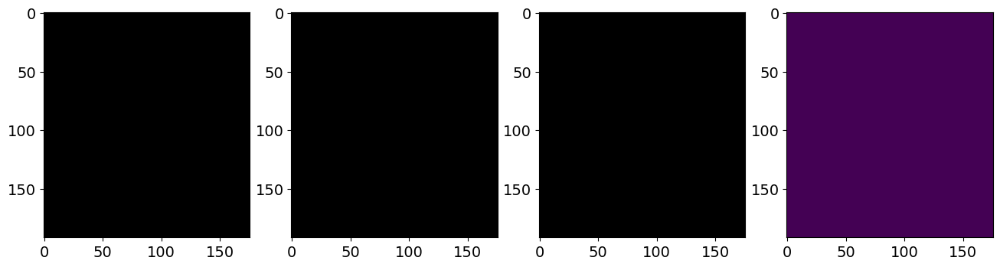

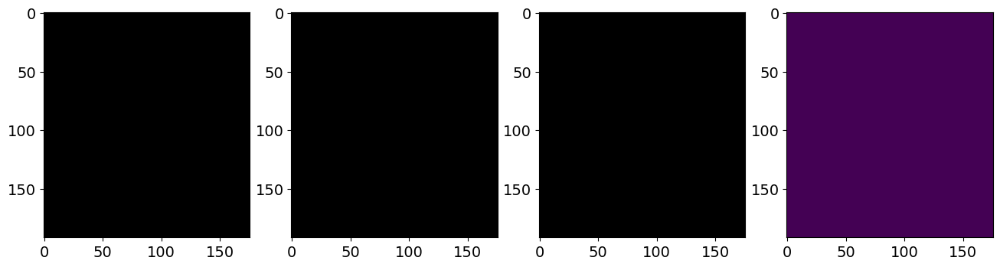

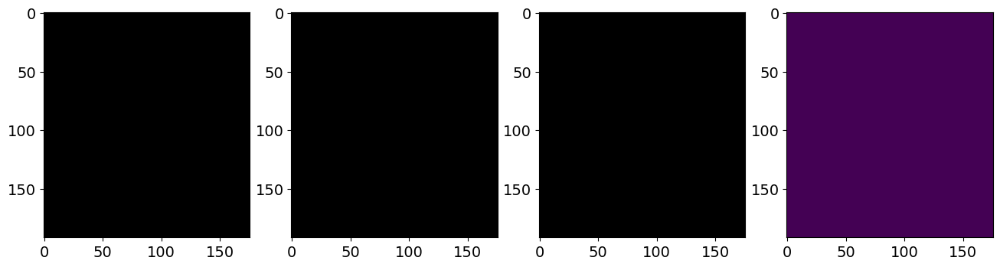

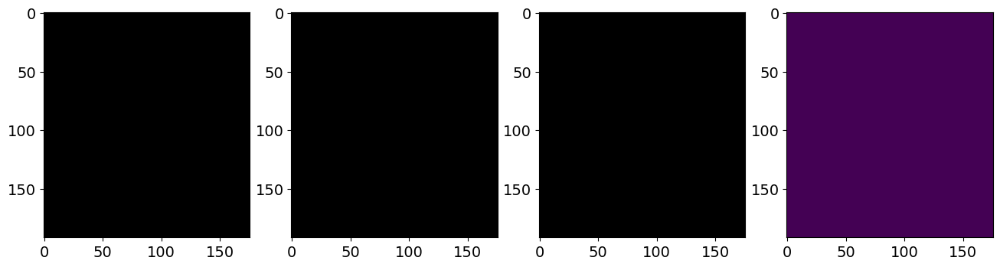

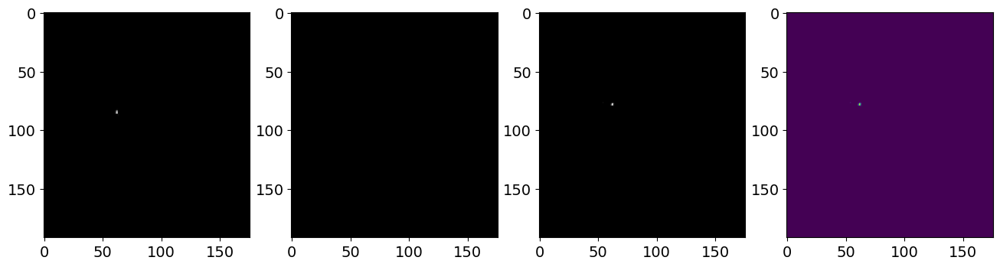

...

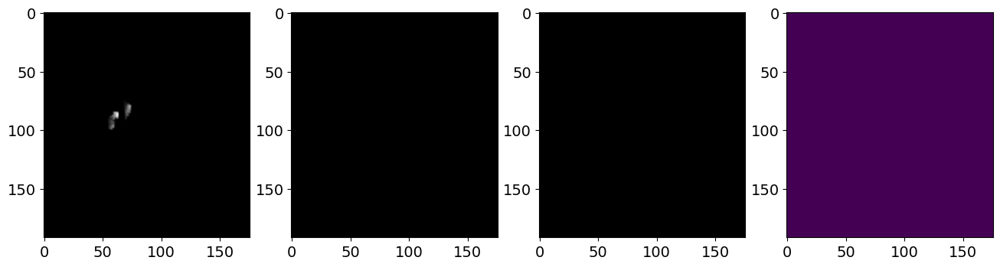

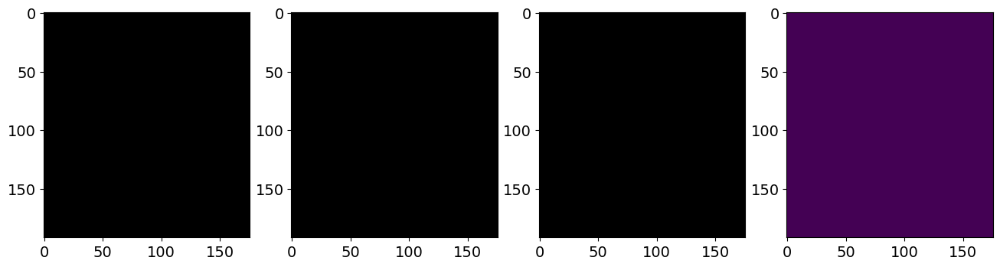

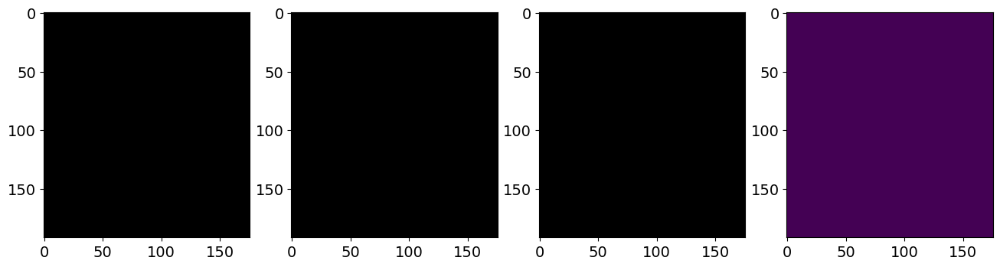

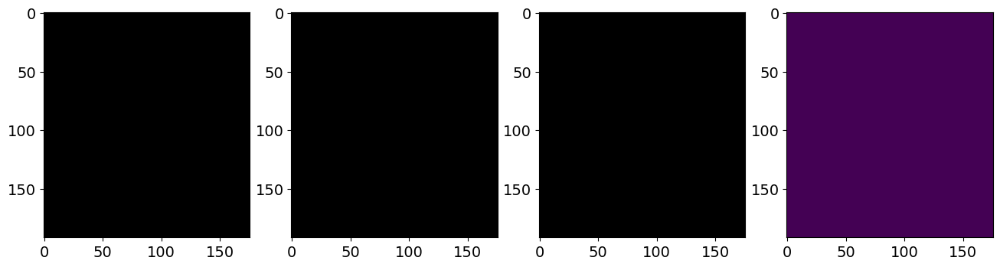

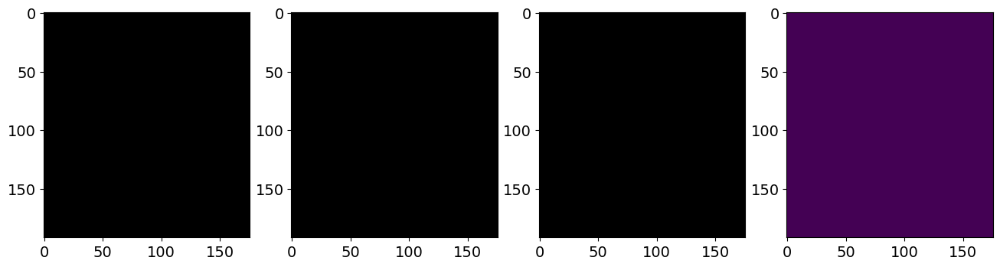

In [109]:
import matplotlib.pyplot as plt
for i in range(160):
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    axes[0].imshow(img_m[0, 0, i].cpu().detach().numpy(), cmap='gray')
    axes[1].imshow(img_f[0, 0, i].cpu().detach().numpy(), cmap='gray')
    axes[2].imshow(img_a[0, 0, i].cpu().detach().numpy(), cmap='gray')
    axes[3].imshow(err_img[0, 0, i].cpu().detach().numpy())
    plt.show()